In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import ascii, votable
from astropy.table import Table, vstack, hstack
import astropy.units as u
from astropy.coordinates import ICRS, Galactic
from scipy.interpolate import interp1d
from galpy.util.bovy_coords import *

dir_rrlyrae = '/datascope/menard/group/scheng/Gaia/'

## Load RR Lyrae

In [6]:
rrlyrae = np.load(dir_rrlyrae+'rrlyrae.npy')[0]['rrlyrae']
table = rrlyrae
len(rrlyrae)

140784

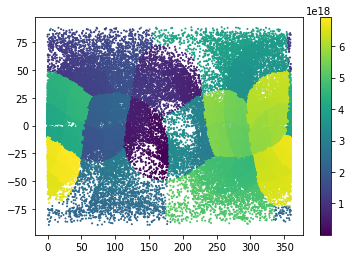

In [7]:
plt.scatter(table['l'],table['b'],c=table['source_id'],alpha=1,s=1)
plt.colorbar()
plt.show()

### Isochrone

In [ ]:
isochrone_sun = Table.read('/home/scheng/Gaia/5Gyr_0.0152.dat',format='ascii')
isochrone_old = Table.read('/home/scheng/Gaia/10Gyr_0.001.dat',format='ascii')
isochrone_mpoor = Table.read('/home/scheng/Gaia/10Gyr_0.000152.dat',format='ascii')
isochrone_mpoor

## Name convenient columns

In [ ]:
table = rrlyrae.copy()

In [8]:
bp_rp = table['bp_rp']
g = table['phot_g_mean_mag']
#g = table['int_average_g']
l = table['l']
b = table['b']
ra = table['ra']
dec = table['dec']
pmra = table['pmra']
pmdec = table['pmdec']
p = table['parallax']

#from astropy.coordinates import ICRS, Galactic
#galactic = ICRS(ra=ra, dec=dec,pm_ra_cosdec=pmra, pm_dec=pmdec).transform_to(Galactic)
distance = 10**((g-0.7+5)/5-3)
XYZ = lbd_to_XYZ(l/180*np.pi,b/180*np.pi,10**((g-0.7+5)/5-3))
pmlpmb = pmrapmdec_to_pmllpmbb(pmra,pmdec,ra/180*np.pi,dec/180*np.pi)
print(XYZ)
print(pmlpmb)

[[  9.10802655  -4.19783224  -1.03176829]
 [ 22.09264977 -10.58961587  -2.66616135]
 [ 90.45642036 -41.75844103 -11.61763133]
 ...
 [  6.57026133 -16.71556775 -19.9292363 ]
 [  3.09334591 -47.89450842 -31.4803686 ]
 [  2.46929123 -40.19813867 -24.41885594]]
[[ 5.26773504 -6.63517575]
 [-4.616059   -1.27742633]
 [        nan         nan]
 ...
 [        nan         nan]
 [-0.35214069  1.96810375]
 [ 0.14033013 -0.04992599]]


In [9]:
def plot_lb_with_select(table,selected,alpha=1):
    plt.figure(figsize=(18,6))

    x = table['l']
    y = table['b']
    
    plt.title('BP - RP, strange RR Lyrae')
    plt.plot(x[selected]-360,y[selected],'.b',alpha=alpha)
    plt.plot(x[selected],y[selected],'.b',alpha=alpha)
    plt.xlim(180,-180)
    plt.ylim(-90,90)
    #plt.colorbar()
    plt.show()

#selected = ((pmlpmb[:,0]+5)**2+(pmlpmb[:,1]+10)**5)**0.5 < 1 # a GC
#selected = pmlpmb[:,0] < -5
#plot_lb_with_select(rrlyrae,selected,0.1)
not_LMC = ~((np.abs(360-65-l)<25) * (np.abs(b+35)<17) * (np.abs(XYZ[:,2]+35)<15))
selection_basis = not_LMC * (sfd_ext<0.5) * (np.array(bp_rp)<1.5)# * (np.array(g)>19)
selected = ((pmlpmb[:,0]-8)**2+(pmlpmb[:,1]-3)**5)**0.5 < 1 # a GC
for i in range(-15,15,5):
    for j in range(-5,5,5):
        selected = (np.abs(pmlpmb[:,0]-i)<2.5) * (np.abs(pmlpmb[:,1]-j)<2.5) * (not_LMC)
        plot_lb_with_select(rrlyrae,selected,0.1)
        print(i,j)

NameError: name 'sfd_ext' is not defined

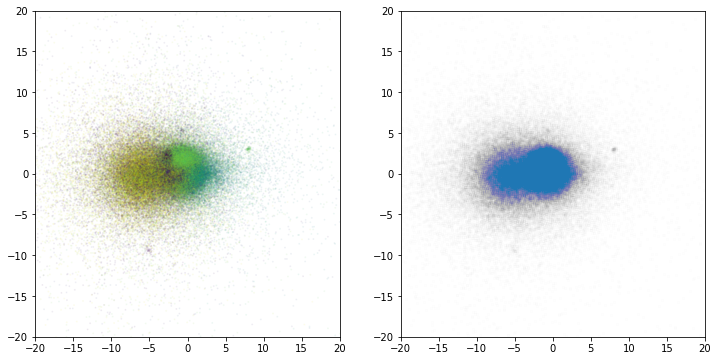

In [10]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.scatter(pmlpmb[:,0],pmlpmb[:,1],s=1,c=l,alpha=0.05)
plt.xlim(-20,20)
plt.ylim(-20,20)

plt.subplot(1,2,2)
plt.plot(pmlpmb[:,0],pmlpmb[:,1],'.',alpha=0.005)
plt.xlim(-20,20)
plt.ylim(-20,20)
plt.show()

## import dustmap

In [11]:
from astropy.coordinates import SkyCoord
from dustmaps.planck import PlanckQuery
from dustmaps.sfd import SFDQuery
from dustmaps.bayestar import BayestarQuery

from dustmaps.config import config
config['data_dir'] = '/datascope/menard/group/scheng/dust/dustmaps'
#config['data_dir'] = ''
#import dustmaps.sfd
#dustmaps.sfd.fetch()

coords = SkyCoord(l, b, distance=(10**((g-0.7+5)/5))*u.pc, frame='galactic')

#planck = PlanckQuery()
#planck(coords)

sfd = SFDQuery()
sfd_ext = sfd(coords)

#bayestar = BayestarQuery() # Bayestar2017 is the default
#bayestar_ext = bayestar(coords, mode='median')

/home/scheng/miniconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters



In [9]:
len(l)

140784

## correlations

In [21]:
bp_rp = table['int_average_bp'] - table['int_average_rp']
#bp_rp = table['bp_rp']

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)



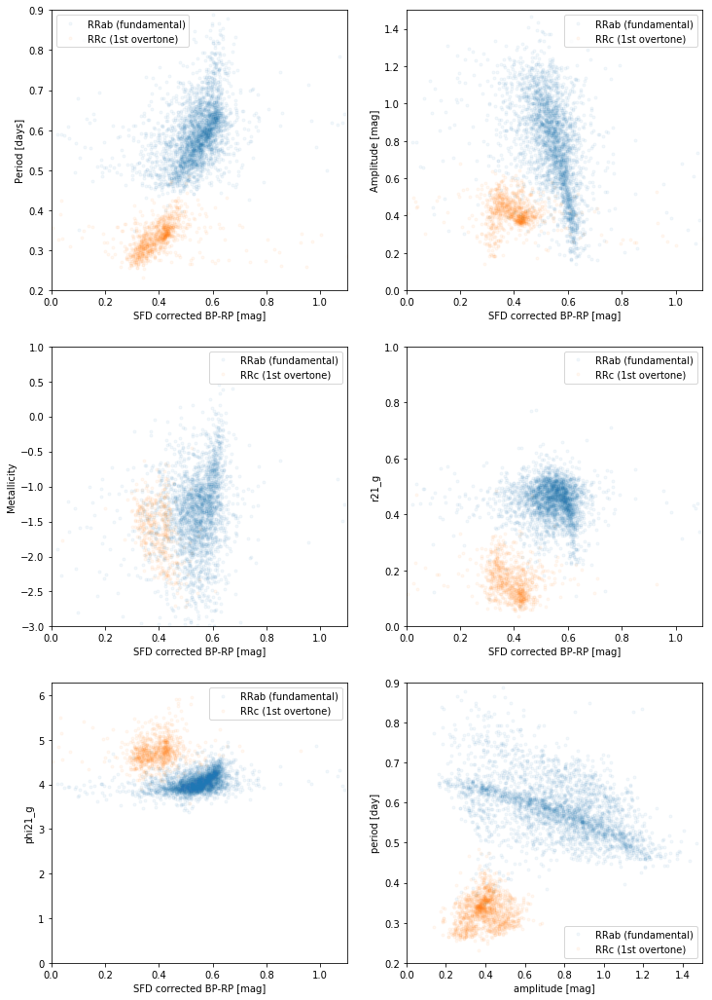

In [22]:
selected_ab = selection_basis * (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRab') * (p>-100) * (table['num_clean_epochs_g']>40)
selected_c = selection_basis * (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRc') * (p>-100) * (table['num_clean_epochs_g']>40)

plt.figure(figsize=(12,18))
x_axis_list_ab = [table['pf'], table['peak_to_peak_g'], table['metallicity'], table['r21_g'], table['phi21_g']  ]
x_axis_list_c = [table['p1_o'], table['peak_to_peak_g'], table['metallicity'], table['r21_g'], table['phi21_g']  ]
title_list = ['Period [days]', 'Amplitude [mag]', 'Metallicity', 'r21_g', 'phi21_g']
y_range_list = [(0.2,0.9), (0.0,1.5), (-3,1), (0,1), (0,2*np.pi)]
for i in range(5):
    plt.subplot(3,2,i+1)
    plt.plot(bp_rp[selected_ab]-sfd_ext[selected_ab],x_axis_list_ab[i][selected_ab],'.',alpha=0.05, label='RRab (fundamental)')
    plt.plot(bp_rp[selected_c]-sfd_ext[selected_c],x_axis_list_c[i][selected_c],'.',alpha=0.05, label='RRc (1st overtone)')
    plt.legend()
    plt.xlim(0,1.1)
    plt.ylim(y_range_list[i])
    plt.xlabel('SFD corrected BP-RP [mag]')
    plt.ylabel(title_list[i])
plt.subplot(3,2,6)
plt.plot(table['peak_to_peak_g'][selected_ab],table['pf'][selected_ab],'.',alpha=0.05, label='RRab (fundamental)')
plt.plot(table['peak_to_peak_g'][selected_c],table['p1_o'][selected_c],'.',alpha=0.05, label='RRc (1st overtone)')
plt.legend()
plt.xlim(0,1.5)
plt.ylim(0.2,0.9)
plt.xlabel('amplitude [mag]')
plt.ylabel('period [day]')


plt.show()

[0.72754991 0.23156188]
[13.45239442  7.58930022]


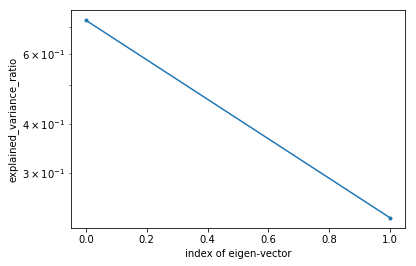

In [61]:
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
selected = np.array(selected_ab) * ~np.isnan(np.array(table['int_average_bp']-table['int_average_rp']-table['peak_to_peak_g']-table['pf']))
X_pca = np.concatenate((np.array(table['peak_to_peak_g'])[selected].reshape(1,-1),np.array(table['pf'])[selected].reshape(1,-1),\
                        np.array(table['int_average_bp']-table['int_average_rp'])[selected].reshape(1,-1))).T
n_components = 2
pca = PCA(n_components=n_components)
pca.fit(X_pca)

linear_model = LinearRegression()
linear_model.fit(X_pca[:,0:1],X_pca[:,2])

print(pca.explained_variance_ratio_)  
print(pca.singular_values_)  
plt.plot(pca.explained_variance_ratio_,'.-')
plt.xlabel('index of eigen-vector')
plt.ylabel('explained_variance_ratio')
plt.yscale('log')
plt.show()

In [66]:
residual = ((X_pca - pca.inverse_transform(pca.transform(X_pca)))**2).sum(axis=1)**0.5
residual = X_pca[:,2] - linear_model.predict(X_pca[:,0:1])

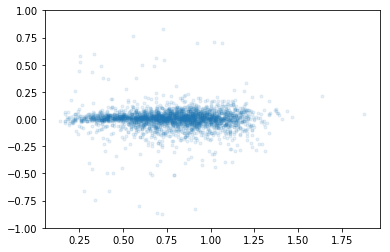

0.1469624602680202


In [77]:
plt.plot((table['peak_to_peak_g'])[selected],residual,'.',alpha=0.1)
plt.ylim(-1,1)
plt.show()
print(residual.std())

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)



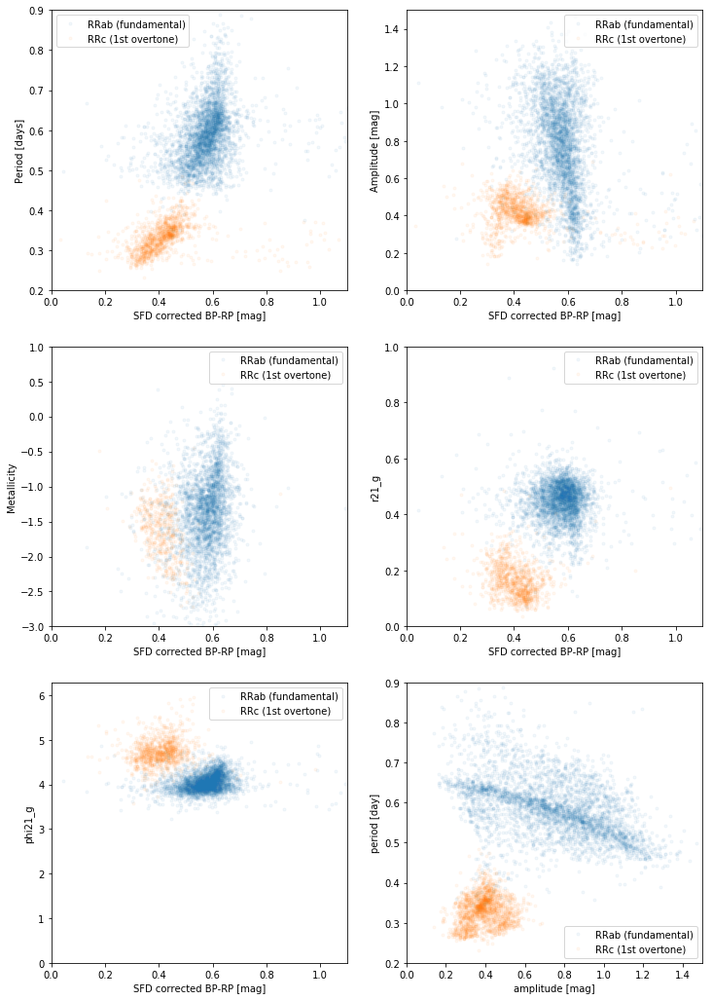

In [15]:
selected_ab = (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRab') * (p>-100) * (table['num_clean_epochs_g']>40)
selected_c = (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRc') * (p>-100) * (table['num_clean_epochs_g']>40)

plt.figure(figsize=(12,18))
x_axis_list_ab = [table['pf'], table['peak_to_peak_g'], table['metallicity'], table['r21_g'], table['phi21_g']  ]
x_axis_list_c = [table['p1_o'], table['peak_to_peak_g'], table['metallicity'], table['r21_g'], table['phi21_g']  ]
title_list = ['Period [days]', 'Amplitude [mag]', 'Metallicity', 'r21_g', 'phi21_g']
y_range_list = [(0.2,0.9), (0.0,1.5), (-3,1), (0,1), (0,2*np.pi)]
for i in range(5):
    plt.subplot(3,2,i+1)
    plt.plot(bp_rp[selected_ab]-sfd_ext[selected_ab],x_axis_list_ab[i][selected_ab],'.',alpha=0.05, label='RRab (fundamental)')
    plt.plot(bp_rp[selected_c]-sfd_ext[selected_c],x_axis_list_c[i][selected_c],'.',alpha=0.05, label='RRc (1st overtone)')
    plt.legend()
    plt.xlim(0,1.1)
    plt.ylim(y_range_list[i])
    plt.xlabel('SFD corrected BP-RP [mag]')
    plt.ylabel(title_list[i])
plt.subplot(3,2,6)
plt.plot(table['peak_to_peak_g'][selected_ab],table['pf'][selected_ab],'.',alpha=0.05, label='RRab (fundamental)')
plt.plot(table['peak_to_peak_g'][selected_c],table['p1_o'][selected_c],'.',alpha=0.05, label='RRc (1st overtone)')
plt.legend()
plt.xlim(0,1.5)
plt.ylim(0.2,0.9)
plt.xlabel('amplitude [mag]')
plt.ylabel('period [day]')


plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)



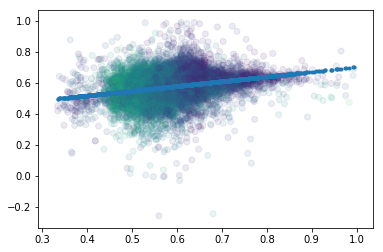

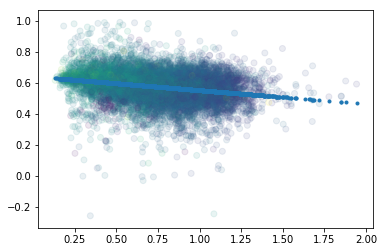

In [11]:
from scipy.optimize import curve_fit

selected_ab = ((np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRab') * (pmra>-100)\
                    * (bp_rp-sfd_ext < 1) )
selected_ab = np.array(selected_ab) * ~selected_ab.mask

pf_to_color = np.poly1d(np.polyfit(table['pf'][selected_ab],bp_rp[selected_ab]-sfd_ext[selected_ab],1))
plt.figure()
plt.scatter(table['pf'][selected_ab],bp_rp[selected_ab]-sfd_ext[selected_ab],c=table['peak_to_peak_g'][selected_ab],alpha=0.1)
plt.plot(table['pf'][selected_ab],pf_to_color(table['pf'][selected_ab]),'.')
plt.show()

amp_to_color = np.poly1d(np.polyfit(table['peak_to_peak_g'][selected_ab],bp_rp[selected_ab]-sfd_ext[selected_ab],1))
plt.figure()
plt.scatter(table['peak_to_peak_g'][selected_ab],bp_rp[selected_ab]-sfd_ext[selected_ab],c=table['pf'][selected_ab],alpha=0.1)
plt.plot(table['peak_to_peak_g'][selected_ab],amp_to_color(table['peak_to_peak_g'][selected_ab]),'.')
plt.show()

#poly2d = lambda period, amp, a0,a1,b0,b1
#amp_to_color = curve_fit(poly2d, np.concatenate([table['peak_to_peak_g'][selected_ab]]) ,bp_rp[selected_ab]-sfd_ext[selected_ab]))
#plt.figure()
#plt.plot(table['peak_to_peak_g'][selected_ab],bp_rp[selected_ab]-sfd_ext[selected_ab],'.')
#plt.plot(table['peak_to_peak_g'][selected_ab],amp_to_color(table['peak_to_peak_g'][selected_ab]),'.')
#plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)



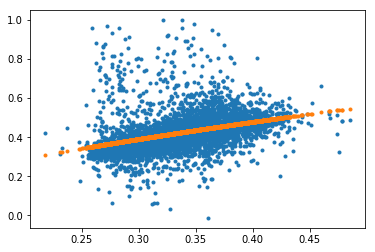

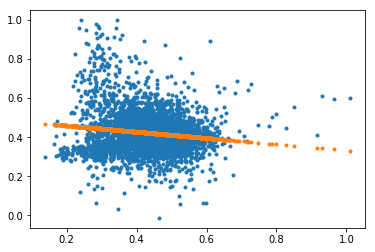

In [12]:
selected_c = ((np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRc') * (pmra>-100)\
                    * (bp_rp-sfd_ext < 1) )
selected_c = np.array(selected_c) * ~selected_c.mask

p1o_to_color = np.poly1d(np.polyfit(table['p1_o'][selected_c],bp_rp[selected_c]-sfd_ext[selected_c],2))

plt.plot(table['p1_o'][selected_c],bp_rp[selected_c]-sfd_ext[selected_c],'.')
plt.plot(table['p1_o'][selected_c],p1o_to_color(table['p1_o'][selected_c]),'.')

amp_to_color = np.poly1d(np.polyfit(table['peak_to_peak_g'][selected_c],bp_rp[selected_c]-sfd_ext[selected_c],1))
plt.figure()
plt.plot(table['peak_to_peak_g'][selected_c],bp_rp[selected_c]-sfd_ext[selected_c],'.')
plt.plot(table['peak_to_peak_g'][selected_c],amp_to_color(table['peak_to_peak_g'][selected_c]),'.')
plt.show()

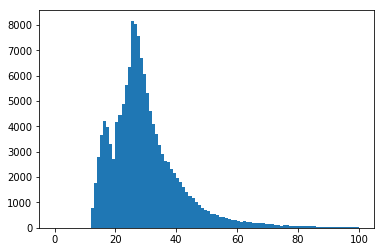

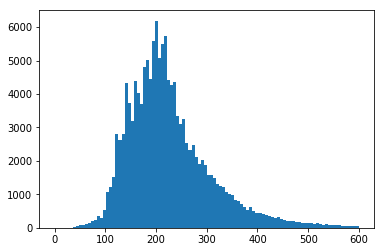

In [653]:
plt.hist(rrlyrae['num_clean_epochs_g'],100,(0,100));plt.show()
plt.hist(rrlyrae['astrometric_n_good_obs_al'],100,(0,600));plt.show()

In [654]:
len(rrlyrae)

140784

# number of visits

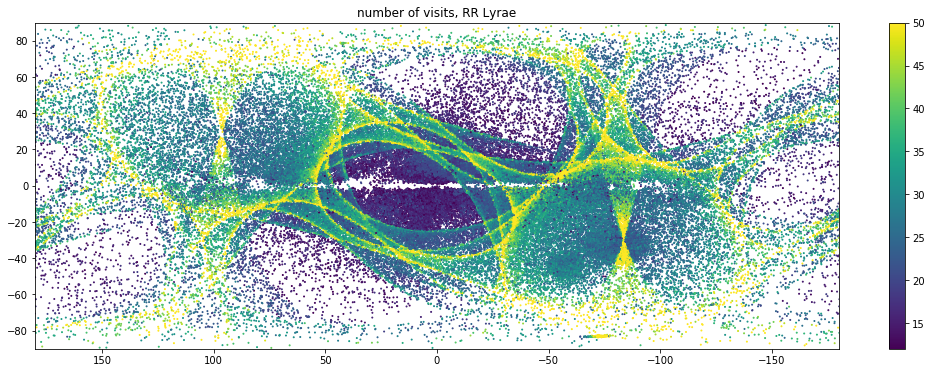

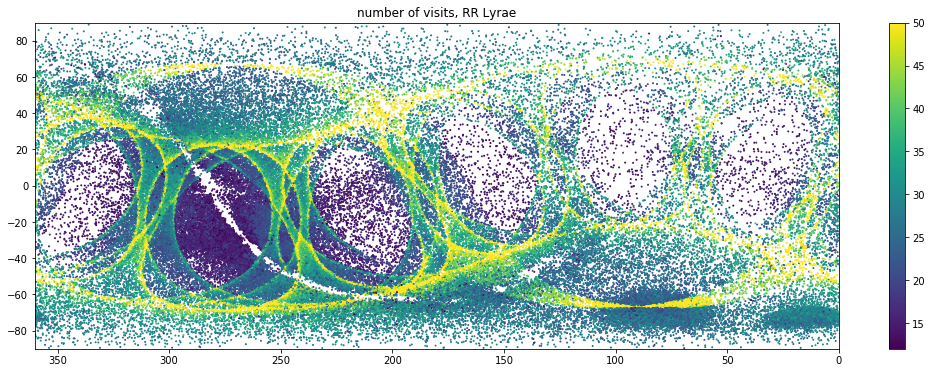

In [234]:
plt.figure(figsize=(18,6))

x = l
y = b
z=  (table['num_clean_epochs_g'])
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = np.where(z<10000)[0]

alpha = 1
vmax = 50

plt.title('number of visits, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],vmax=vmax,alpha=alpha)
plt.scatter(x[selected],y[selected],1,c=z[selected],vmax=vmax,alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
x = ra
y = dec
plt.title('number of visits, RR Lyrae')
plt.scatter(x[selected],y[selected],1,c=z[selected],vmax=vmax,alpha=alpha)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

# number of vists (CCD transit)

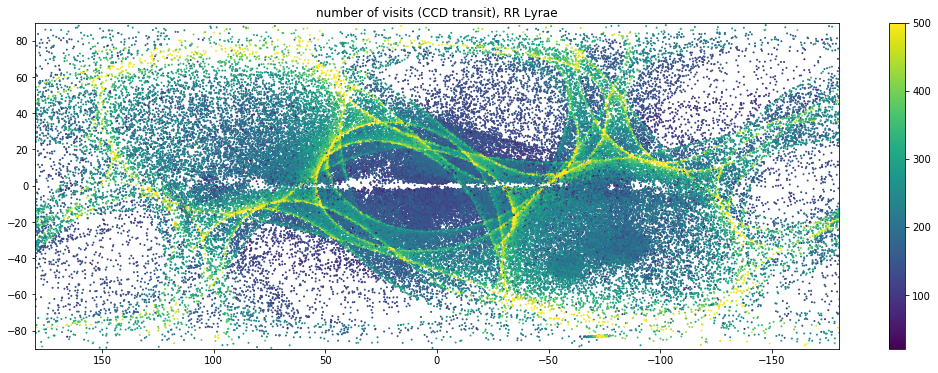

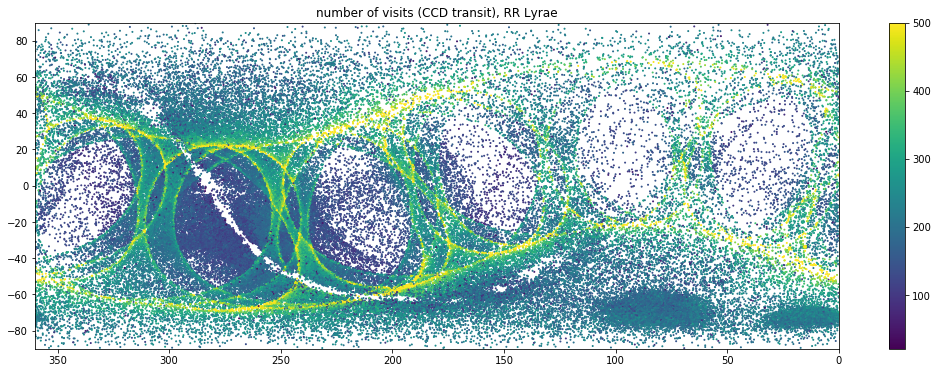

In [663]:
plt.figure(figsize=(18,6))

x = l
y = b
z=  (table['astrometric_n_good_obs_al'])
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = np.where(z<10000)[0]

alpha = 1
vmax = 500

plt.title('number of visits (CCD transit), RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],vmax=vmax,alpha=alpha)
plt.scatter(x[selected],y[selected],1,c=z[selected],vmax=vmax,alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
x = ra
y = dec
plt.title('number of visits (CCD transit), RR Lyrae')
plt.scatter(x[selected],y[selected],1,c=z[selected],vmax=vmax,alpha=alpha)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

# G mag for RR Lyrae

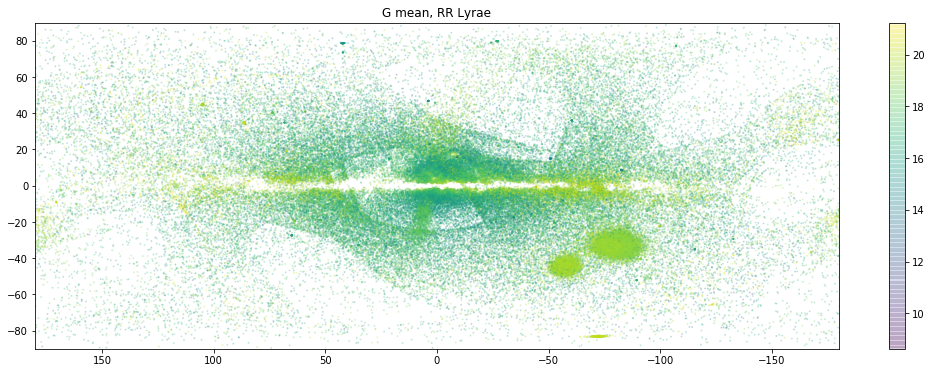

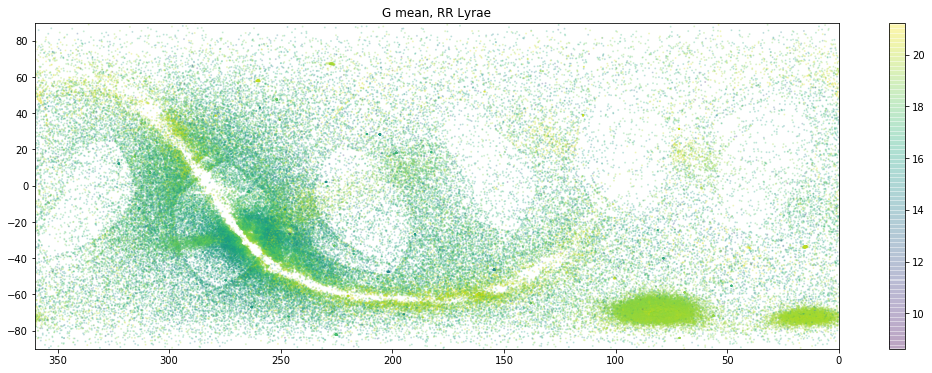

In [664]:
alpha = 0.2

plt.figure(figsize=(18,6))
plt.title('G mean, RR Lyrae')
plt.scatter(l-360,b,1,c=g,alpha=alpha)
plt.scatter(l,b,1,c=g,alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
plt.title('G mean, RR Lyrae')
plt.scatter(ra,dec,1,c=g,alpha=alpha)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

# BP-RP for RR Lyrae

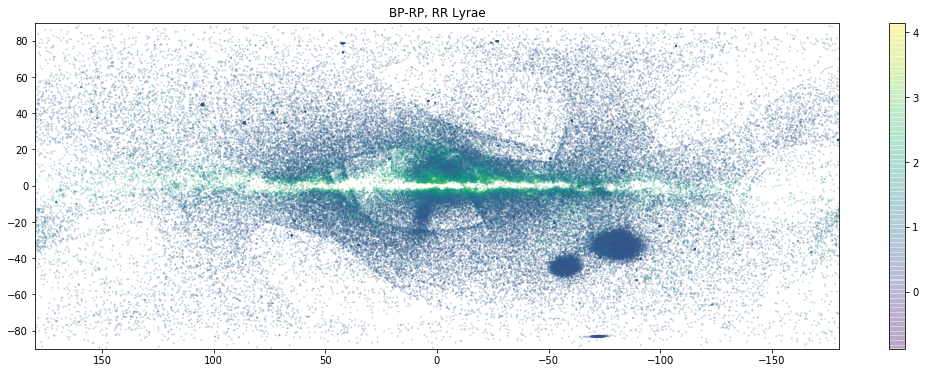

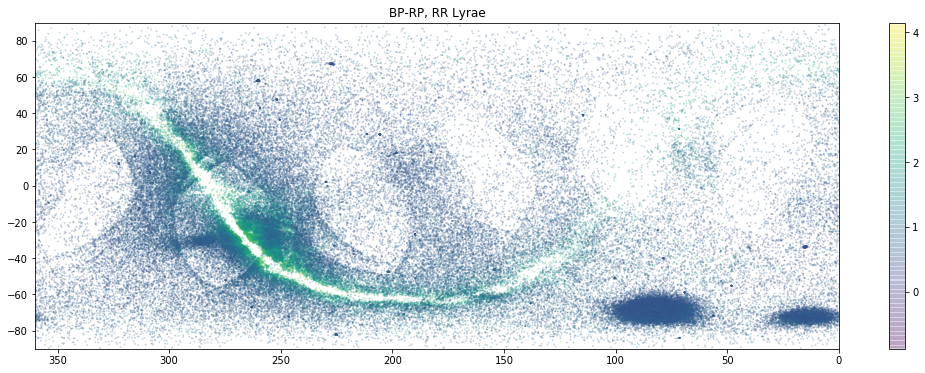

In [675]:
alpha = 0.2

plt.figure(figsize=(18,6))
plt.title('BP-RP, RR Lyrae')
plt.scatter(l-360,b,1,c=bp_rp,alpha=alpha)
plt.scatter(l,b,1,c=bp_rp,alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
plt.title('BP-RP, RR Lyrae')
#plt.scatter(table.array['ra']-360,table.array['dec'],1,c=table.array['bp_rp'],alpha=0.1)
plt.scatter(ra,dec,1,c=bp_rp,alpha=alpha)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

# BP-RP for strange RR Lyrae

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)


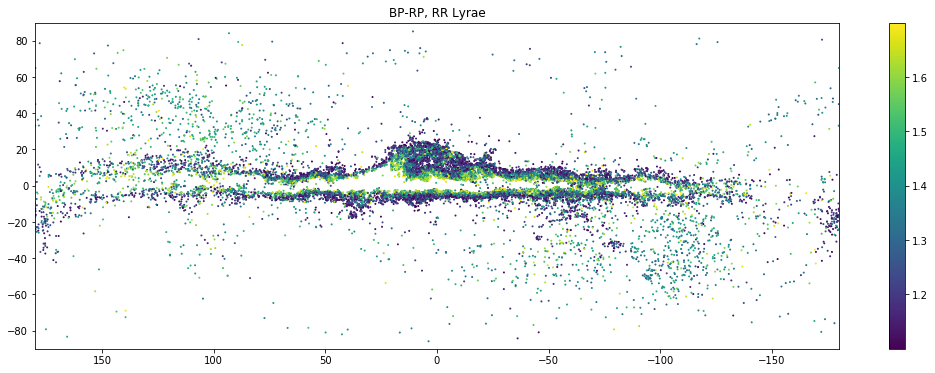

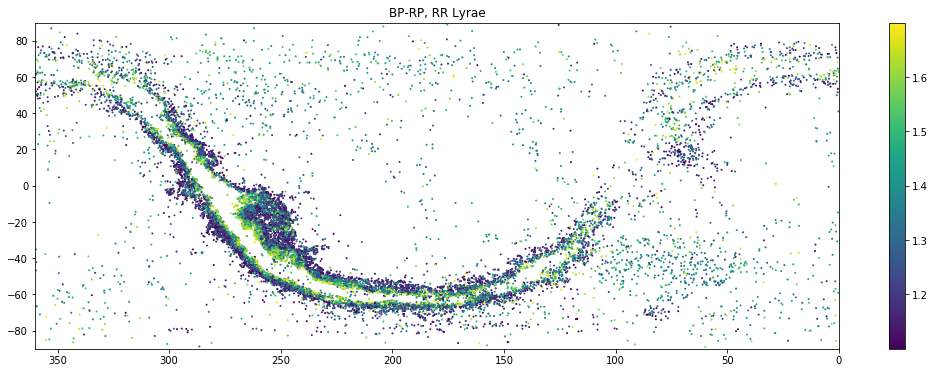

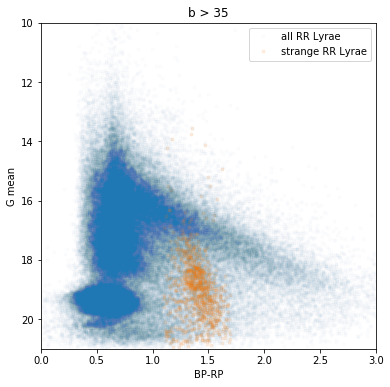

In [677]:
plt.figure(figsize=(18,6))

x = l
y = b
z= bp_rp
selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) )[0]

alpha = 1

plt.title('BP-RP, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
x = ra
y = dec
plt.title('BP-RP, RR Lyrae')
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(6,6))
x = bp_rp
y = g
selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (np.abs(b)>35) )[0]
plt.plot(x,y,'.',alpha=0.01,label='all RR Lyrae')
plt.plot(x[selected],y[selected],'.',alpha=0.1,label='strange RR Lyrae')

plt.legend()
plt.title('b > 35')
plt.ylim(21,10)
plt.xlim(-0.,3)
plt.xlabel('BP-RP')
plt.ylabel('G mean')
plt.show()

# Proper motion in DEC for RR Lyrae

/Users/scheng/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)



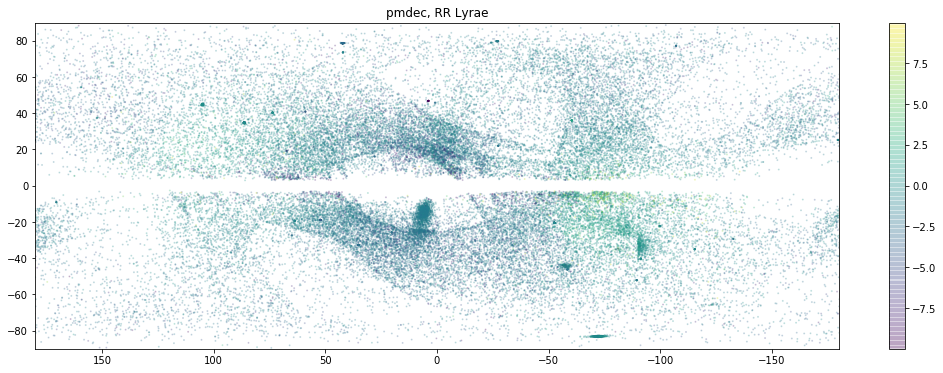

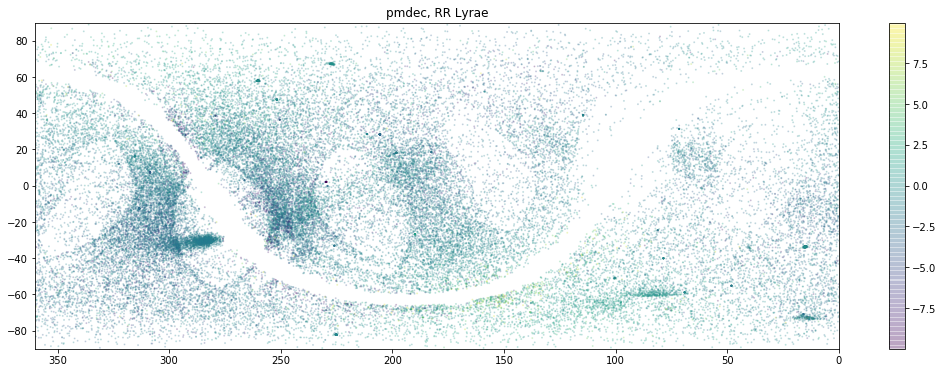

In [81]:
plt.figure(figsize=(18,6))

x = l
y = b
z = pmdec
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = (np.abs(z)<10) *  ~((np.abs(360-65-l)<25) * (np.abs(b+35)<17) * (np.abs(XYZ[:,2]+35)<15)) * (np.abs(XYZ[:,2])>5)

alpha = 0.2

plt.title('pmdec, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
x = ra
y = dec
plt.title('pmdec, RR Lyrae')
#plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=1)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

# proper motion in l, b

/Users/scheng/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in less
  import sys



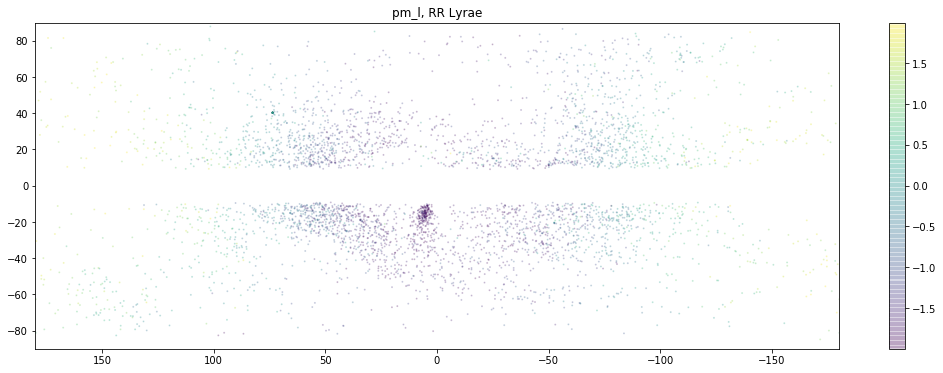

/Users/scheng/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in less



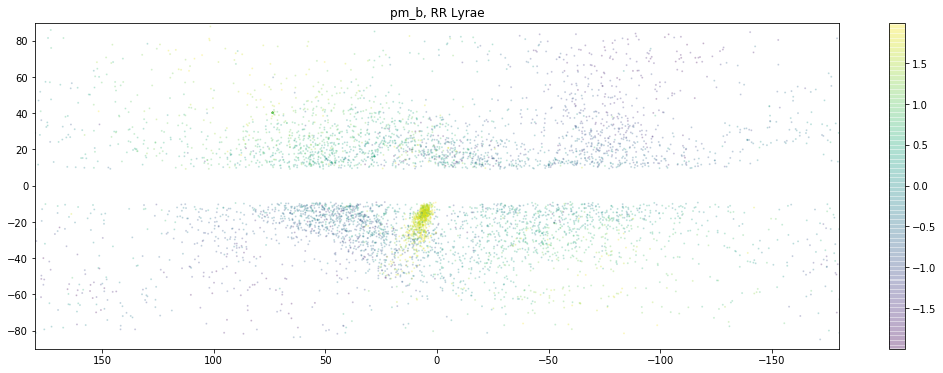

In [92]:
plt.figure(figsize=(18,6))

x = l
y = b
z = pmlpmb[:,0]
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = (np.abs(g-18)<0.25) * (np.abs(z)<2) *  ~((np.abs(360-65-l)<30) * (np.abs(b+35)<20) * (np.abs(XYZ[:,2]+35)<15)) * (np.abs(XYZ[:,2])>5)


alpha = 0.2
#cmap = 'seismic'

plt.title('pm_l, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
z = pmlpmb[:,1]
selected = (np.abs(g-18)<0.25) * (np.abs(z)<2) *  ~((np.abs(360-65-l)<30) * (np.abs(b+35)<20) * (np.abs(XYZ[:,2]+35)<15)) * (np.abs(XYZ[:,2])>5)

plt.title('pm_b, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

/Users/scheng/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in less
  import sys



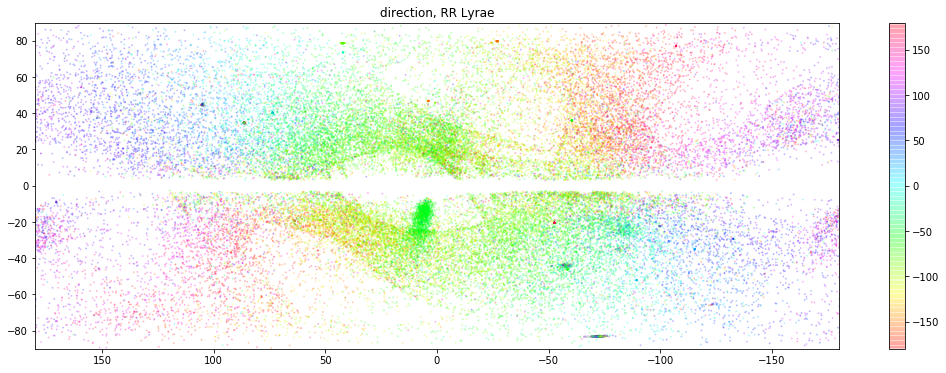

In [89]:
plt.figure(figsize=(18,6))

x = l
y = b
z = 180/np.pi*np.arctan2(pmlpmb[:,0], pmlpmb[:,1])
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = (np.abs(z)<180) *  ~((np.abs(360-65-l)<30) * (np.abs(b+35)<20) * (np.abs(XYZ[:,2]+35)<15)) * (np.abs(XYZ[:,2])>5)


alpha = 0.2
cmap = 'hsv'

plt.title('direction, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha,cmap=cmap)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha,cmap=cmap)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

#plt.figure(figsize=(18,6))
#x = ra
#y = dec
#plt.title('pm_l, RR Lyrae')
##plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=1)
#plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha,cmap=cmap)
#plt.xlim(360,0)
#plt.ylim(-90,90)
#plt.colorbar()
#plt.show()

## metallicity

/Users/scheng/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)



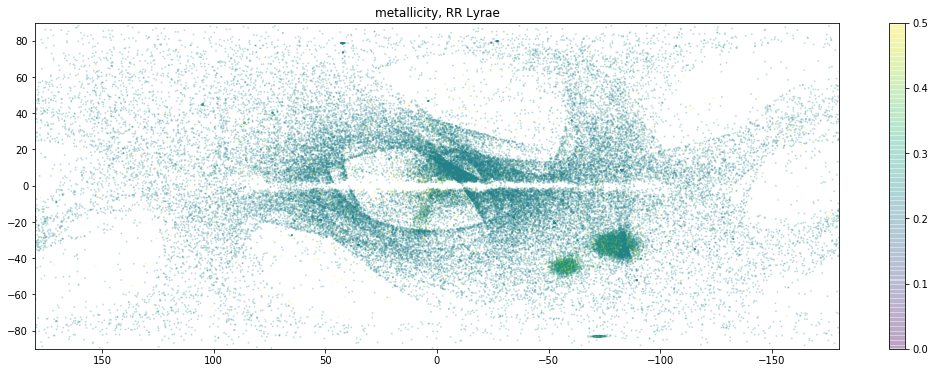

In [79]:
plt.figure(figsize=(18,6))

x = l
y = b
z = table['metallicity_error']
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = np.where( (np.abs(z)<500)  )[0]

alpha = 0.2
#cmap = ''

#plt.style.use('dark_background')
plt.title('metallicity, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha,vmin=0,vmax=0.5)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha,vmin=0,vmax=0.5)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

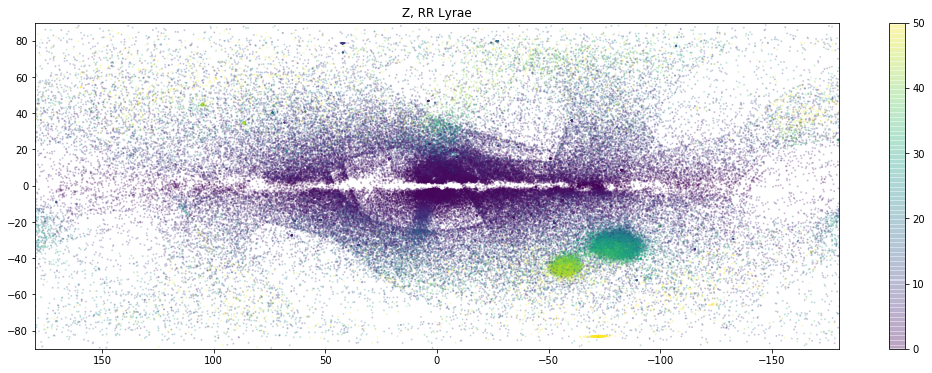

In [70]:
plt.figure(figsize=(18,6))

x = l
y = b
z = np.abs(XYZ[:,2])
#selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * (z<5)  )[0]
selected = np.where( (np.abs(z)<500)  )[0]

alpha = 0.2
#cmap = ''

#plt.style.use('dark_background')
plt.title('Z, RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=alpha,vmin=0,vmax=50)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=alpha,vmin=0,vmax=50)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

In [76]:
(np.abs(XYZ[:,2]-35)<15).sum()

5149

/Users/scheng/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:973: RuntimeWarning: invalid value encountered in greater_equal
  not_smaller_than_edge = (sample[:, i] >= edges[i][-1])

/Users/scheng/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: divide by zero encountered in log10
  



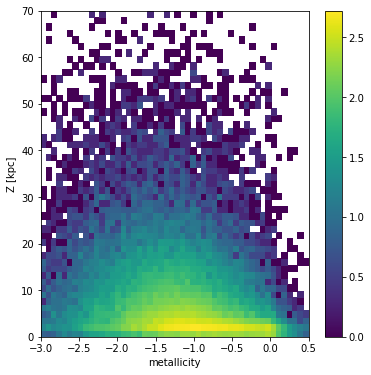

In [77]:
plt.figure(figsize=(6,6))
#plt.title('star density [lg(n), arbitrary unit]')

selected = ~((np.abs(360-65-l)<25) * (np.abs(b+35)<17) * (np.abs(XYZ[:,2]+35)<15))
H, xedges, yedges = np.histogram2d(table['metallicity'][selected], np.abs(XYZ[:,2]-0.03)[selected], bins=(50, 50),range=((-3,0.5),(0,70)))
H = H.T
X_display, Y_display = np.meshgrid(xedges, yedges)
plt.pcolormesh(X_display, Y_display, np.log10(H))
plt.xlabel('metallicity')
plt.ylabel('Z [kpc]')
#plt.xlim(x1,x2)
#plt.ylim(y1,y2)
plt.colorbar()
plt.show()

# CMD of b > 35

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in less
  This is separate from the ipykernel package so we can avoid doing imports until
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in less
  after removing the cwd from sys.path.


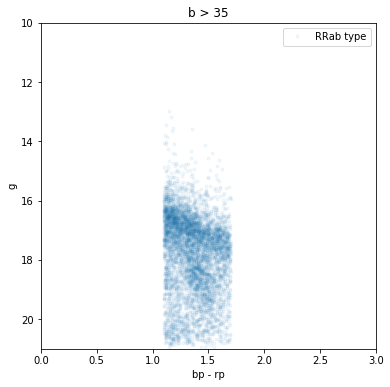

In [371]:
plt.figure(figsize=(6,6))

selected = np.where((np.abs(bp_rp-1.45)<0.1) * (np.abs(g-19)<0.5))[0]
selected = np.where((np.abs(bp_rp-1.4)<0.3) * (np.abs(g-19)<9.5) * ((table.array['best_classification']==b'RRc')))[0]


x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
y = table.array['phot_g_mean_mag']
plt.plot(x[selected],y[selected],'.',alpha=0.05,label='RRab type')

plt.legend()

plt.title('b > 35')
plt.ylim(21,10)
plt.xlim(-0.,3)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.show()

## bp - rp for strange RR Lyrae

/Users/scheng/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)



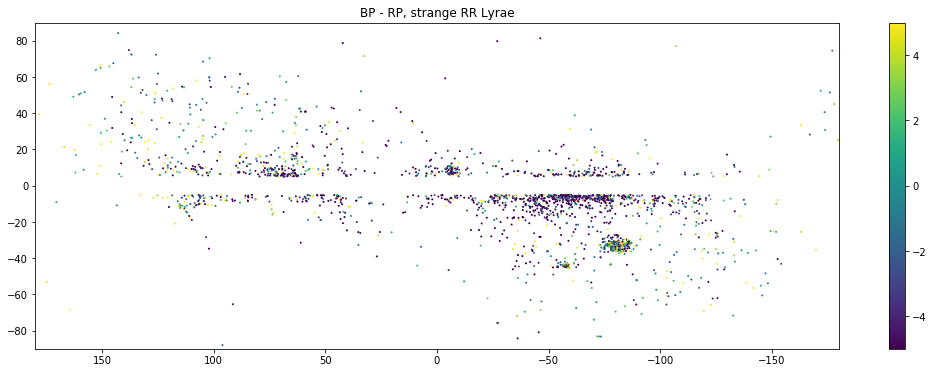

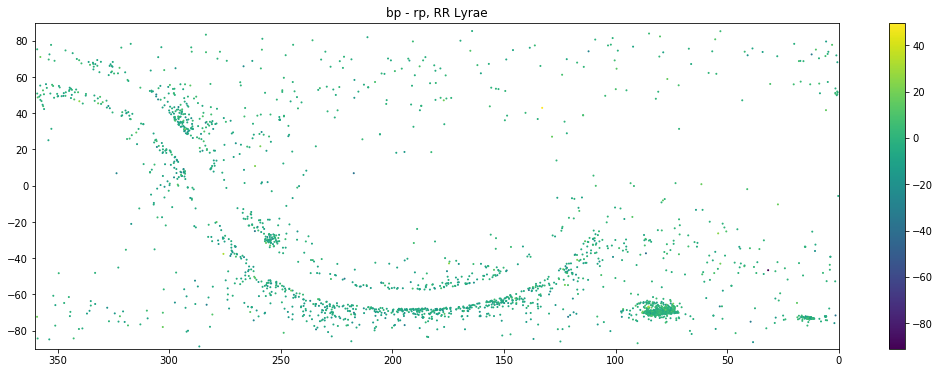

In [236]:
plt.figure(figsize=(18,6))

x = l
y = b
z = pmlpmb[:,0]
selected = np.where((np.abs(bp_rp-0.5)<0.3) * (np.abs(g-19)<0.3) )[0]
selected = np.where((np.abs(table['b'])>35) * (np.abs(bp_rp-0.5)<0.2) \
                   * (np.abs(g-19.2)<1.5) \
                   * (np.abs(l+80-360)<10) * (b<-25))[0]

selected = np.where((np.abs(b-78.7)<0.2) * (np.abs(l-42.1)<1))[0]
selected = (table['astrometric_excess_noise']>3) * (np.abs(table['b'])>5)



plt.title('BP - RP, strange RR Lyrae')
plt.scatter(x[selected]-360,y[selected],1,c=z[selected],alpha=1,vmin=-5,vmax=5)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=1,vmin=-5,vmax=5)
plt.xlim(180,-180)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

plt.figure(figsize=(18,6))
x = ra
y = dec
plt.title('bp - rp, RR Lyrae')
#plt.scatter(x[selected]-360,y[selected],1,c=bp_rp[selected],alpha=1)
plt.scatter(x[selected],y[selected],1,c=z[selected],alpha=1)
plt.xlim(360,0)
plt.ylim(-90,90)
plt.colorbar()
plt.show()

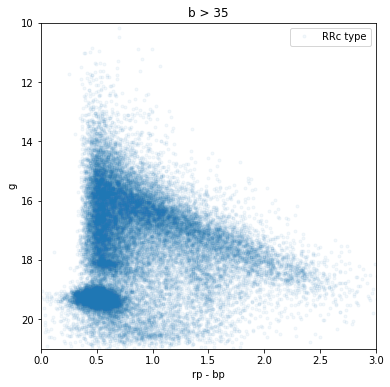

In [255]:
plt.figure(figsize=(6,6))
#selected = np.where((np.abs(table.array['b'])<35) * (table.array['best_classification']==b'RRab'))[0]
#x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
#y = table.array['phot_g_mean_mag']
#plt.plot(x[selected],y[selected],'.',alpha=0.005,label='RRab type')


selected = np.where((np.abs(table.array['b'])<35) * (table.array['best_classification']==b'RRc'))[0]
x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
y = table.array['phot_g_mean_mag']
plt.plot(x[selected],y[selected],'.',alpha=0.05,label='RRc type')

plt.legend()

plt.title('b > 35')
plt.ylim(21,10)
plt.xlim(-0.,3)
plt.xlabel('rp - bp')
plt.ylabel('g')
plt.show()

## All properties in CMD

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)


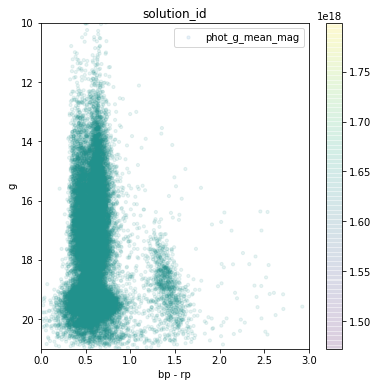

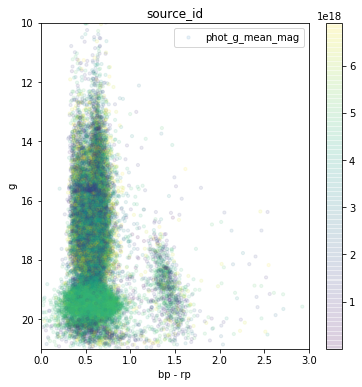

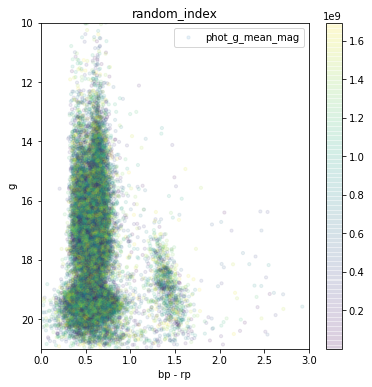

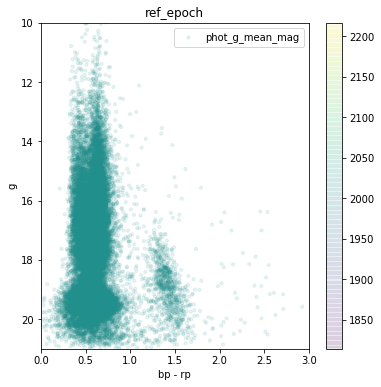

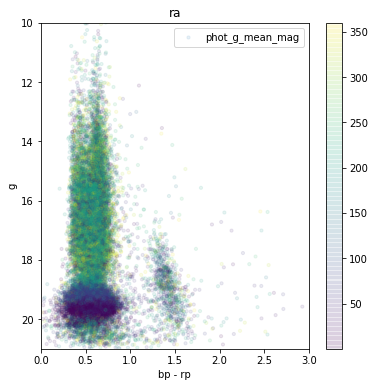

...

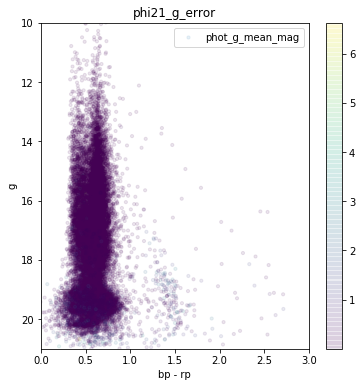

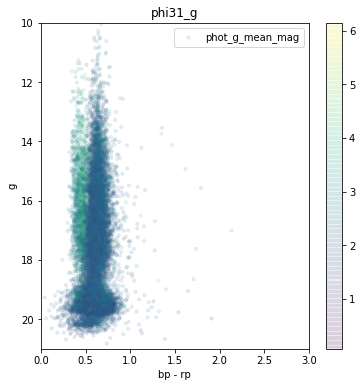

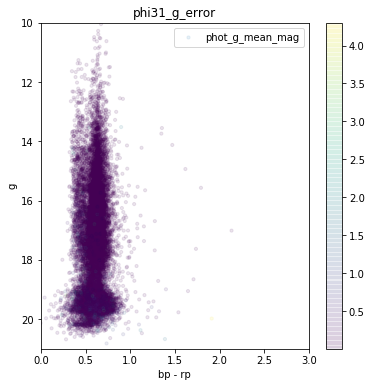

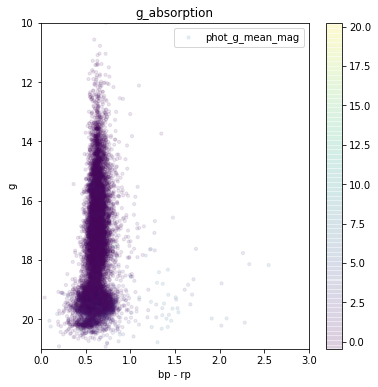

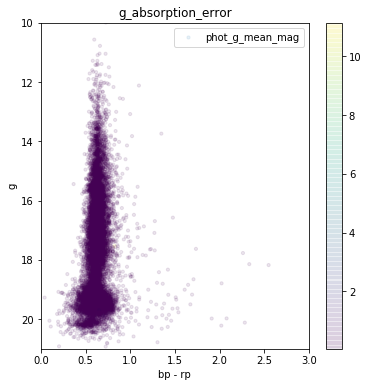

In [79]:
table = rrlyrae
for i,key in enumerate(table.keys()):
    if table[key].dtype == float or table[key].dtype == int:
        plt.figure(figsize=(6,6))
        selected = np.where((np.abs(b)>35) \
                           * (table['num_clean_epochs_g']<100000) * (np.abs(bp_rp-1.4)<100000.2))[0]
        #selected = np.where((np.abs(table.array['b'])>25) * (np.abs(table.array['bp_rp']-0.5)<0.2) \
        #                   * (np.abs(table.array['phot_g_mean_mag']-19.2)<1.5) \
        #                   * (np.abs(table.array['l']+80-360)<10) * (np.abs(table.array['b']+35)<10))[0]
        
        x = bp_rp
        y = g #- table['g_absorption']
        z = table[key]
        plt.scatter(x[selected],y[selected],10,z[selected],alpha=0.1)#,label='RRc type')
        
        plt.legend()
        plt.colorbar()
        
        plt.title(key)
        plt.ylim(21,10)
        plt.xlim(-0.,3)
        plt.xlabel('bp - rp')
        plt.ylabel('g')
        plt.show()

In [ ]:
table['phot_bp_rp_excess_factor']

/Users/scheng/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)



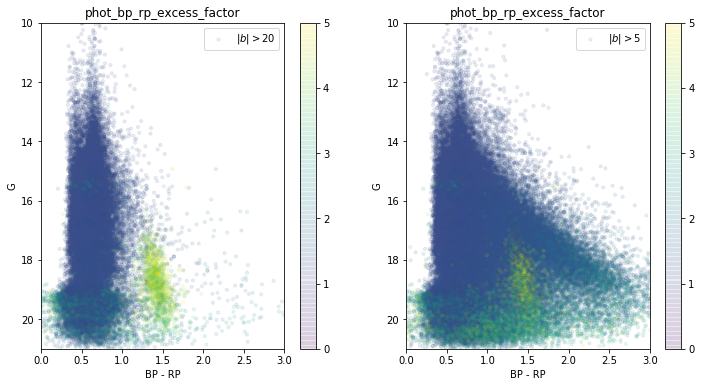

In [231]:
table = rrlyrae
for i,key in enumerate(['phot_bp_rp_excess_factor']):
#for i,key in enumerate(['astrometric_excess_noise']):
    if (table[key].dtype == float or table[key].dtype == int) or table[key].dtype =='float32':
        plt.figure(figsize=(12,6))
        selected = (np.abs(b)>20) \
                           * (table['num_clean_epochs_g']<100000) * (np.abs(bp_rp-1.4)<100000.2)
        selected_2 = (np.abs(b)>0) \
                           * (table['num_clean_epochs_g']<100000) * (np.abs(bp_rp-1.4)<100000.2)
        #selected = np.where((np.abs(table.array['b'])>25) * (np.abs(table.array['bp_rp']-0.5)<0.2) \
        #                   * (np.abs(table.array['phot_g_mean_mag']-19.2)<1.5) \
        #                   * (np.abs(table.array['l']+80-360)<10) * (np.abs(table.array['b']+35)<10))[0]
        
        x = bp_rp
        y = g #- table['g_absorption']
        z = table[key]
        plt.subplot(1,2,1)
        plt.scatter(x[selected],y[selected],10,z[selected],alpha=0.1,vmin=0,vmax=5,label="$\|b\|>20$")#,label='RRc type')
        plt.legend()
        plt.colorbar()
        
        plt.title(key)
        plt.ylim(21,10)
        plt.xlim(-0.,3)
        plt.xlabel('BP - RP')
        plt.ylabel('G')
        
        
        plt.subplot(1,2,2)
        plt.scatter(x[selected_2],y[selected_2],10,z[selected_2],alpha=0.1,vmin=0,vmax=5,label="$\|b\|>5$")#,label='RRc type')
       
        plt.legend()
        plt.colorbar()
        
        plt.title(key)
        plt.ylim(21,10)
        plt.xlim(-0.,3)
        plt.xlabel('BP - RP')
        plt.ylabel('G')
        plt.show()

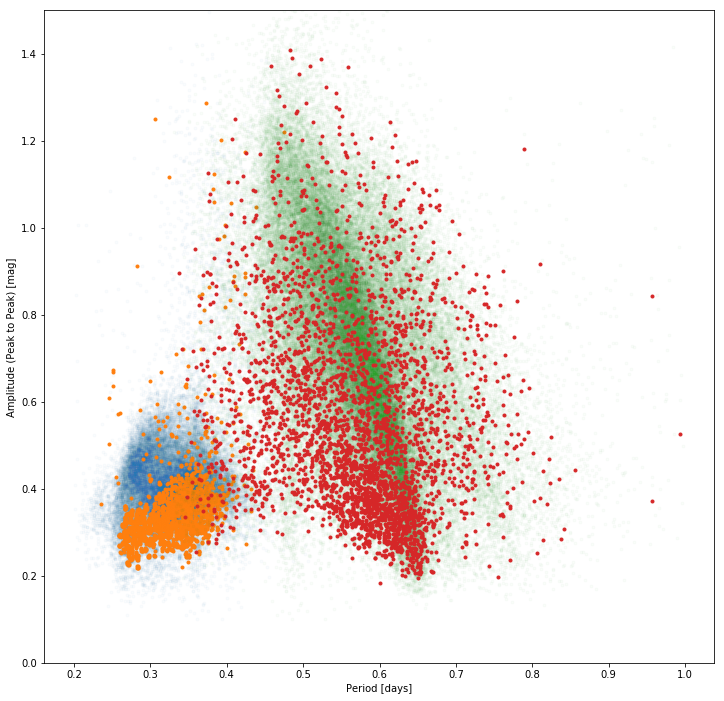

In [232]:
plt.figure(figsize=(12,12))
selected = table['astrometric_excess_noise']>5
selected_rr = table['astrometric_excess_noise']<5
plt.plot(table['p1_o'][selected_rr],table['peak_to_peak_g'][selected_rr],'.',alpha=0.02)
plt.plot(table['p1_o'][selected],table['peak_to_peak_g'][selected],'.',alpha=1)

plt.plot(table['pf'][selected_rr],table['peak_to_peak_g'][selected_rr],'.',alpha=0.02)
plt.plot(table['pf'][selected],table['peak_to_peak_g'][selected],'.',alpha=1)

plt.xlabel('Period [days]')
plt.ylabel('Amplitude (Peak to Peak) [mag]')

plt.ylim(0,1.5)
plt.show()

## Before and after period - colour correction

In [143]:
(table['parallax_error']/table['parallax']).sum()

/Users/scheng/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)



1806

In [214]:
((table['astrometric_excess_noise']>5)*(np.abs(table['b'])>20)).sum()

2250

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)


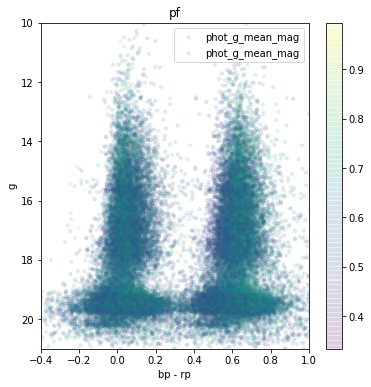

In [276]:
key = 'pf'
plt.figure(figsize=(6,6))
selected = np.where((np.abs(b)>35) \
                   * (table['num_clean_epochs_g']<100000) * (np.abs(bp_rp-1.4)<100000.2) *\
                    (table['best_classification']==b'RRab'))[0]
#selected = np.where((np.abs(table.array['b'])>25) * (np.abs(table.array['bp_rp']-0.5)<0.2) \
#                   * (np.abs(table.array['phot_g_mean_mag']-19.2)<1.5) \
#                   * (np.abs(table.array['l']+80-360)<10) * (np.abs(table.array['b']+35)<10))[0]

x = bp_rp# - pf_to_color(table['pf'])
y = g #- table['g_absorption']
z = table[key]
plt.scatter(x[selected],y[selected],10,z[selected],alpha=0.1)#,label='RRc type')

x = bp_rp - pf_to_color(table['pf'])
y = g #- table['g_absorption']
z = table[key]
plt.scatter(x[selected],y[selected],10,z[selected],alpha=0.1)#,label='RRc type')


plt.legend()
plt.colorbar()

plt.title(key)
plt.ylim(21,10)
plt.xlim(-0.4,1)
plt.xlabel('bp - rp')
plt.ylabel('g')
plt.show()

## parallax of ordinary RR Lyrae G~18.7

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in less
  This is separate from the ipykernel package so we can avoid doing imports until
/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:780: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:781: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


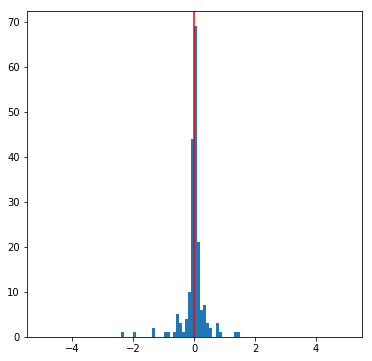

511.28014405451006 0.0019558748987783597


In [453]:
plt.figure(figsize=(6,6))
# LMC
selected = np.where((np.abs(table.array['b'])>25) * (np.abs(table.array['bp_rp']-0.5)<0.2) \
                   * (np.abs(table.array['phot_g_mean_mag']-19.2)<1.5) \
                   * (np.abs(table.array['l']+80-360)<10) * (np.abs(table.array['b']+35)<10))[0]
# GC1
selected = np.where((np.abs(b-78.7)<0.2) * (np.abs(l-42.1)<1))[0]


x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
y = table.array['phot_g_mean_mag']
z = table.array['parallax']
average = z[selected].mean()
plt.hist(z[selected],100,(-5,5));
plt.axvline(average,color='r')
plt.show()
print(1/average, average)

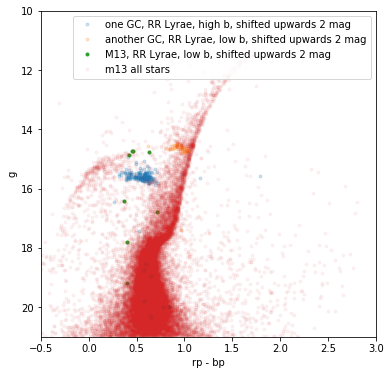

In [468]:
plt.figure(figsize=(6,6))

selected = np.where((np.abs(b-78.7)<0.2) * (np.abs(l-42.1)<1))[0]
x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
y = table.array['phot_g_mean_mag']
plt.plot(x[selected],y[selected],'.',alpha=0.2, label='one GC, RR Lyrae, high b, shifted upwards 2 mag')

selected = np.where((np.abs(b-8.6)<0.2) * (np.abs(l-277.4)<0.2))[0]
x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
y = table.array['phot_g_mean_mag']
plt.plot(x[selected],y[selected],'.',alpha=0.2,label='another GC, RR Lyrae, low b, shifted upwards 2 mag')

selected = np.where((np.abs(b-40.91192302)<0.2) * (np.abs(l-59.00933845)<0.2))[0]
x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
y = table.array['phot_g_mean_mag']
plt.plot(x[selected],y[selected],'.',alpha=1,label='M13, RR Lyrae, low b, shifted upwards 2 mag')


#selected = np.where((np.abs(b+32.5)<10) * (np.abs(l-280)<15))[0]
#x = table.array['phot_bp_mean_mag']-table.array['phot_rp_mean_mag']
#y = table.array['phot_g_mean_mag']
#plt.plot(x[selected],y[selected],'.',alpha=0.01)

#selected = np.where((np.abs(b+32.5)<10) * (np.abs(l-280)<15))[0]
x = m13.array['phot_bp_mean_mag']-m13.array['phot_rp_mean_mag']
y = m13.array['phot_g_mean_mag']
plt.plot(x,y,'.',alpha=0.05,label='m13 all stars')

plt.legend()
plt.xlabel('rp - bp')
plt.ylabel('g')
plt.ylim(21,10)
plt.xlim(-0.5,3)
plt.show()

In [ ]:
# plt.figure(figsize=(12,12))
x = table.array['parallax']
y = table.array['phot_g_mean_mag']
plt.plot(x,y,'.',alpha=0.1)
plt.ylim(20,8)
plt.show()

## analyse dustmap

In [114]:
coords = SkyCoord(l.reshape(-1,1)*np.ones((1,10))*u.deg, b.reshape(-1,1)*np.ones((1,10))*u.deg, \
                  distance=(10**((np.arange(10,20,1)+5)/5)).reshape(1,-1)*np.ones((140784,1))*u.pc, \
                  frame='galactic')

In [115]:
bay_multidistance = BayestarQuery() # Bayestar2017 is the default
bay_multidistance_ext = bayestar(coords, mode='median')

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:4033: RuntimeWarning: Invalid value encountered in median for 780950 results
  r = func(a, **kwargs)


/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in less
  


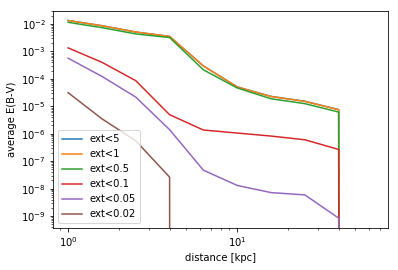

In [353]:
for maglim in [5,1,0.5,0.1,0.05,0.02]:
    y = bay_multidistance_ext[(bay_multidistance_ext.max(axis=1)<maglim)*(b>10)]
    
    plt.plot((10**((np.arange(10,20,1)+5)/5)/1000), (y[:,-1].reshape(-1,1)-y).mean(axis=0),label='ext<'+str(maglim))
plt.legend()
plt.xscale('log')
plt.xlabel('distance [kpc]')
plt.ylabel('average E(B-V)')
#plt.ylim(0,0.0001)
plt.yscale('log')
plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in less
  


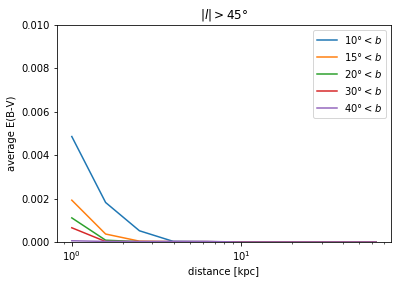

In [354]:
for blim in [10,15,20,30,40]:
    y = bay_multidistance_ext[(bay_multidistance_ext.max(axis=1)<1)*(b>blim)*(l>45)*(l<315)]
    
    plt.plot((10**((np.arange(10,20,1)+5)/5)/1000), (y[:,-1].reshape(-1,1)-y).mean(axis=0),\
             label=str(blim)+r'$\degree<b$')
plt.legend()
plt.xscale('log')
plt.xlabel('distance [kpc]')
plt.ylabel('average E(B-V)')
plt.ylim(1e-6,0.01)
plt.title(r'$ | l |>45 \degree $')
#plt.yscale('log')
plt.show()

In [183]:
((bay_multidistance_ext.max(axis=1)<1)*(b>40)*(l>45)*(l<315)).sum()

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


6370

In [149]:
(~np.isnan(bay_multidistance_ext.mean(axis=1))*(bay_multidistance_ext.max(axis=1)<0.5)).sum()

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


51295

## plot median color

In [357]:
def bootstrap(sample,times):
    n = len(sample)
    if n == 0:
        return 0
    else:
        median = np.empty(times)
        for i in range(times):
            median[i] = np.median(sample[np.random.randint(n,size=n)])
        return median.std()

def plot_color(color,extcut=0.1,times=20,display_all=True):
    selected = np.where((np.abs(b)>35) * (table['best_classification']==b'RRab')\
                       * ~bp_rp.mask * (sfd_ext<extcut) * (table['astrometric_excess_noise']<5))[0]
    x = color[selected]
    y = g[selected]
    x_median = np.zeros(n)
    x_median_error = np.zeros(n)
    for i in range(n):
        selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100))[0]
        x_median[i] = np.median(x[selected])
        x_median_error[i] = bootstrap(x[selected],times)

    plt.plot(x,y,'.',alpha=0.1)
    plt.errorbar( x_median ,(y_bin[:-1]+y_bin[1:])/2, 0, x_median_error,'-r',label='RRab')
    x_median_ab = x_median
    x_median_error_ab = x_median_error
    
    
    selected = np.where((np.abs(b)>35) * (table['best_classification']==b'RRc') \
                        * ~bp_rp.mask * (sfd_ext<extcut) * (table['astrometric_excess_noise']<5))[0]
    x = color[selected]
    y = g[selected]
    x_median = np.zeros(n)
    x_median_error = np.zeros(n)
    for i in range(n):
        selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100))[0]
        x_median[i] = np.median(x[selected])
        x_median_error[i] = bootstrap(x[selected],times)

    plt.plot(x,y,'.',alpha=0.1)
    plt.errorbar( x_median ,(y_bin[:-1]+y_bin[1:])/2, 0, x_median_error,'-b',label='RRc')
    x_median_c = x_median
    x_median_error_c = x_median_error
    
    
    selected = np.where((np.abs(b)>35) \
                        * ~bp_rp.mask * (sfd_ext<extcut) * (table['astrometric_excess_noise']<5))[0]
    x = color[selected]
    y = (g)[selected]
    x_median = np.zeros(n)
    x_median_error = np.zeros(n)
    for i in range(n):
        selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100))[0]
        x_median[i] = np.median(x[selected])
        x_median_error[i] = bootstrap(x[selected],times)

    #plt.plot(x,y,'.',alpha=0.1)
    if display_all==True:
        plt.errorbar( x_median ,(y_bin[:-1]+y_bin[1:])/2, 0, x_median_error, '-k',label='all')
    
        
    plt.legend()
    plt.ylim(20,8)
    plt.xlim(-0.5,3.0)
    plt.xlim(0.3,0.8)
    plt.title('median color')
    plt.xlabel('BP-RP')
    plt.ylabel('G')
    return x_median, x_median_error, x_median_ab, x_median_error_ab, x_median_c, x_median_error_c

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:664: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedColumn.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning: Warning: converting a masked element to nan.


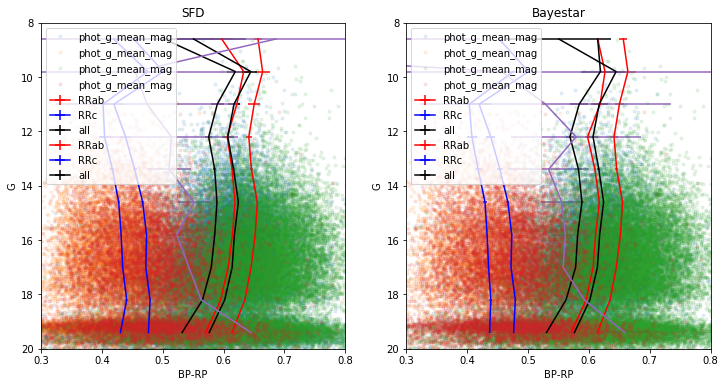

In [303]:
n = 10
y_bin = np.linspace(8,20,n+1)

color_sfd = bp_rp - sfd_ext/1.24

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
x_median_sfd, x_median_error_sfd,_,_,_,_ = plot_color(color_sfd)
x_median, x_median_error,_,_,_,_ = plot_color(bp_rp)
errorbar = np.sqrt(x_median_error**2+x_median_error_sfd**2)*10
plt.errorbar((x_median - x_median_sfd)*10+0.2, (y_bin[:-1]+y_bin[1:])/2, 0, \
             errorbar)
plt.title('SFD')

color_bayestar = bp_rp - bayestar_ext/1.24
plt.subplot(1,2,2)
x_median_bayestar, x_median_error_bayestar,_,_,_,_ = plot_color(color_bayestar)
x_median, x_median_error, _,_,_,_ = plot_color(bp_rp)
errorbar = np.sqrt(x_median_error**2+x_median_error_bayestar**2)*10
plt.errorbar((x_median - x_median_bayestar)*10+0.2, (y_bin[:-1]+y_bin[1:])/2, 0, \
             errorbar)
plt.title('Bayestar')
plt.show()

In [130]:
temp_c['residual'].std()

0.048811095942616754

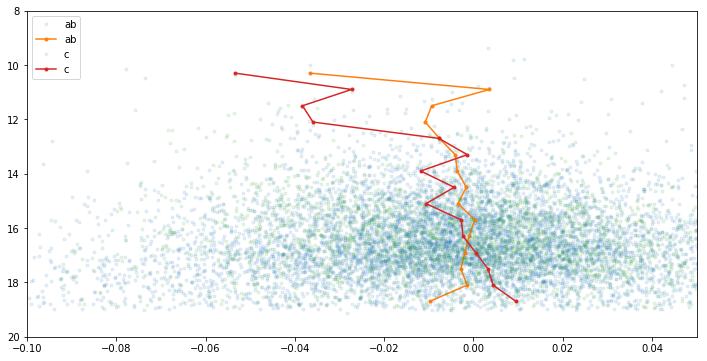

In [134]:
temp_c = np.load(dir_rrlyrae+'g_residual_c.npy')[0]
temp_ab = np.load(dir_rrlyrae+'g_residual.npy')[0]
y = temp['g']
x_1 = temp['residual']
#x_2 = temp['residual_pre']

def plot_rrlyrae_bin_median(x_1,y,n,label):
    x_1_median = np.zeros(n)
    #x_2_median = np.zeros(n)
    y_bin = np.linspace(10,19,n+1)
    for i in range(n):
        selected = (y > y_bin[i]) * (y < y_bin[i+1]) * (x_1>-100)# * (x_2>-100)
        x_1_median[i] = np.median(x_1[selected])
    #    x_2_median[i] = np.mean(x_2[selected])
    
    plt.plot(x_1,y,'.',alpha=0.1,label=label)
    plt.plot(x_1_median*1,(y_bin[:-1]+y_bin[1:])/2,'.-',label=label)
    #plt.plot(x_2_median*1,(y_bin[:-1]+y_bin[1:])/2,'.-')
    plt.ylim(20,8)
    plt.xlim(-0.1,0.05)

plt.figure(figsize=(12,6))
plot_rrlyrae_bin_median(temp_ab['residual'],temp_ab['g'],15,'ab')
plot_rrlyrae_bin_median(temp_c['residual'],temp_c['g'],15,'c')
plt.legend()
plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:664: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedColumn.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:19: UserWarning: Warning: converting a masked element to nan.
/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning: Warning: converting a masked element to nan.
/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:51: UserWarning: Warning: converting a masked element to nan.


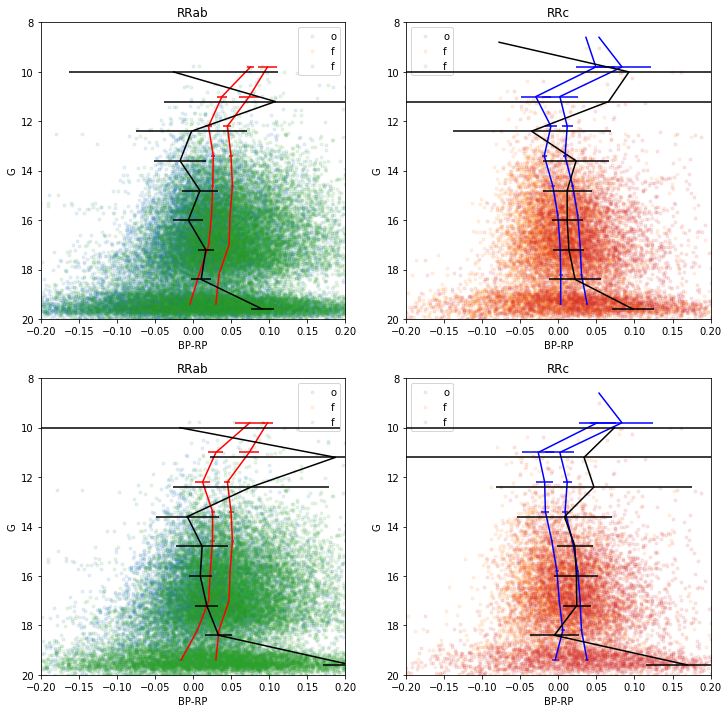

In [363]:
n = 10
times = 20
ext = [sfd_ext, bayestar_ext]

y_bin = np.linspace(8,20,n+1)
plt.figure(figsize=(12,12))
for i in [0,1]:
    plt.subplot(2,2,i*2+1)
    color_sfd = bp_rp - ext[i]/1.24 - pf_to_color(table['pf'])
    _,_,x_median_sfd, x_median_error_sfd,_,_ = plot_color(color_sfd,times=times,display_all=False)
    _,_,x_median, x_median_error,_,_ = plot_color(bp_rp - pf_to_color(table['pf']),times=times,display_all=False)
    errorbar = np.sqrt(x_median_error**2+x_median_error_sfd**2)*10
    plt.errorbar((x_median - x_median_sfd)*10+0.2-0.45, (y_bin[:-1]+y_bin[1:])/2 + 0.2, 0, \
                 errorbar,'k',zorder=10)
    plt.title('RRab')
    plt.xlim(-0.2,0.2)
    plt.legend('off')
    
    
    plt.subplot(2,2,i*2+2)
    color_sfd = bp_rp - ext[i]/1.24 - p1o_to_color(table['p1_o'])
    _,_,_,_,x_median_sfd, x_median_error_sfd = plot_color(color_sfd,times=times,display_all=False)
    _,_,_,_,x_median, x_median_error = plot_color(bp_rp - p1o_to_color(table['p1_o']),times=times,display_all=False)
    errorbar = np.sqrt(x_median_error**2+x_median_error_sfd**2)*10
    plt.errorbar((x_median - x_median_sfd)*10+0.2-0.45, (y_bin[:-1]+y_bin[1:])/2 + 0.2, 0, \
                 errorbar,'k',zorder=10)
    plt.title('RRc')
    plt.xlim(-0.2,0.2)
    plt.legend('off')

plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)


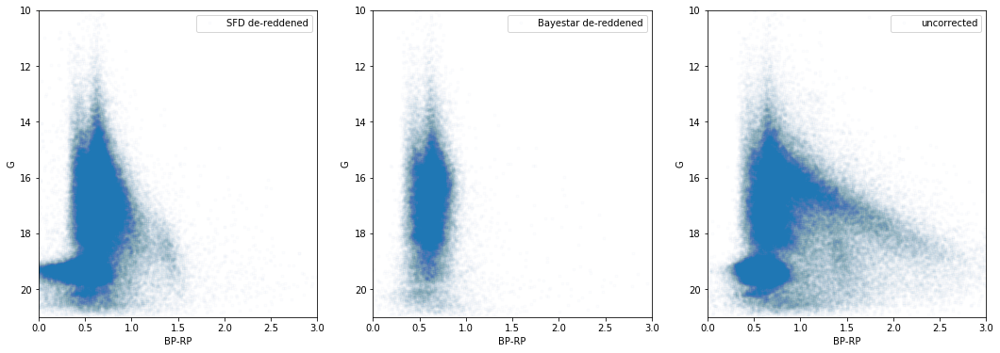

In [85]:
plt.figure(figsize=(18,6))

alpha = 0.01

plt.subplot(1,3,1)
x = color_sfd
y = g
selected = x>(-10000)
plt.plot(x[selected],y[selected],'.',alpha=alpha,label='SFD de-reddened')
plt.legend()
#plt.title('b > 35')
plt.ylim(21,10)
plt.xlim(-0.,3)
plt.xlabel('BP-RP')
plt.ylabel('G')

plt.subplot(1,3,2)
x = color_bayestar
selected = (x>(-10000)) * (sfd_ext<0.5) * (table['astrometric_excess_noise']<5)
plt.plot(x[selected],y[selected],'.',alpha=alpha,label='Bayestar de-reddened')
plt.legend()
#plt.title('b > 35')
plt.ylim(21,10)
plt.xlim(-0.,3)
plt.xlabel('BP-RP')
plt.ylabel('G')

plt.subplot(1,3,3)
x = bp_rp
selected = x>(-10000)
plt.plot(x[selected],y[selected],'.',alpha=alpha,label='uncorrected')
plt.legend()
#plt.title('b > 35')
plt.ylim(21,10)
plt.xlim(-0.,3)
plt.xlabel('BP-RP')
plt.ylabel('G')
plt.show()

## G - parallax check

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in greater
  import sys
/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)
/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


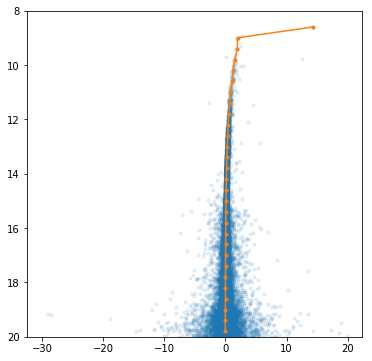

In [47]:
n = 30
y_bin = np.linspace(8,20,n+1)
x = np.array(p)
y = np.array(g)
x_median = np.zeros(n)
for i in range(n):
    selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100) * (bp_rp<1)\
                        )[0]
    x_median[i] = np.median(x[selected])

plt.figure(figsize=(6,6))
plt.plot(x,y,'.',alpha=0.1)
plt.plot( x_median ,(y_bin[:-1]+y_bin[1:])/2, '.-')
plt.ylim(20,8)
plt.show()

## get rid of GC

In [17]:
import numpy as np
from matplotlib import pyplot as plt
from astropy.table import Table

def load_gc():    
    lb = np.genfromtxt('../notebook/gc.txt',skip_header = 1,dtype=None,delimiter=[12,40,6,10,5],usecols=(2,3,4))
    lb[:,2] = 5*np.log10(lb[:,2]*1000)-5    
    return lb[:,0], lb[:,1], lb[:,2]
l_gc, b_gc, m_M_gc = load_gc()
manu_gc = np.array([[105,45],[86.5,34.5],[287.5,-83],[260,-22]])

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in less
  This is separate from the ipykernel package so we can avoid doing imports until

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in greater

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in greater

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in greater

/home/scheng/miniconda3/lib/python3.6/site-packages/matplotlib/scale.py:11

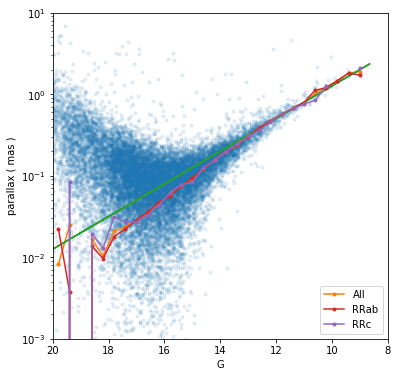

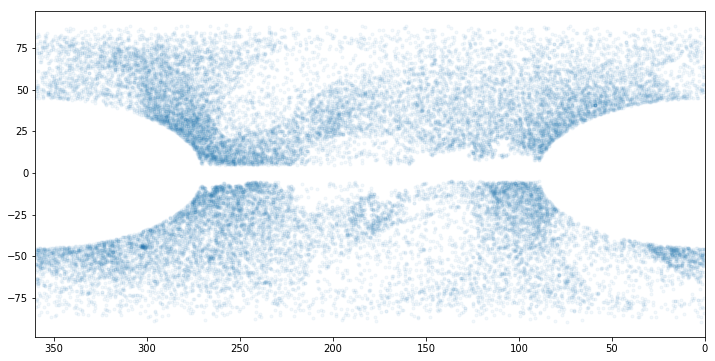

In [19]:
not_LMC = ~( ( (((np.abs(303-l)*np.cos(45/180*np.pi))**2+np.abs(b+45)**2)**0.5 < 10)+\
             (((np.abs(280-l)*np.cos(32/180*np.pi))**2+np.abs(b+32)**2)**0.5 < 15) ) * (np.abs(XYZ[:,2]+35)<20) )

selection_basis = not_LMC * (sfd_ext<0.5) * (np.abs(b)>5) * (np.array(bp_rp)<1.5)
selection_basis = selection_basis * ((((l/2)**2+b**2)**0.5)>45) * (((((360-l)/2)**2+b**2)**0.5)>45)

# not LMC, low extinction, not strange RR lyrae
for i in range(len(l_gc)):
    not_gc_i = ~(  (((((l-l_gc[i])*np.cos(b_gc[i]/180*np.pi))**2 + (b-b_gc[i])**2)**0.5) < 1) *\
                    (np.abs(g-0.5-m_M_gc[i])<0.5) )
    selection_basis = selection_basis * not_gc_i

for i in range(len(manu_gc)):
    not_gc_i = ~(  (((((l-manu_gc[i,0])*np.cos(manu_gc[i,1]/180*np.pi))**2 + (b-manu_gc[i,1])**2)**0.5) < 1) )
    selection_basis = selection_basis * not_gc_i

plt.figure(figsize=(6,6))

n = 30
y_bin = np.linspace(8,20,n+1)
x = np.array(p)
y = np.array(g)
x_median = np.zeros(n)
for i in range(n):
    selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100) * selection_basis \
                        )[0]
    x_median[i] = np.median(x[selected])

plt.plot(y[selection_basis],x[selection_basis],'.',alpha=0.1)
plt.plot(  (y_bin[:-1]+y_bin[1:])/2, x_median, '.-', label='All')
plt.plot(y, 10**(-(y-0.5+5)/5)*1000)  # reference line


x_median = np.zeros(n)
for i in range(n):
    selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100) * selection_basis\
                       * (table['best_classification']==b'RRab') )[0]
    x_median[i] = np.median(x[selected])

#plt.plot(y,x,'.',alpha=0.1)
plt.plot(  (y_bin[:-1]+y_bin[1:])/2, x_median, '.-', label='RRab')

x_median = np.zeros(n)
for i in range(n):
    selected = np.where((y > y_bin[i]) * (y < y_bin[i+1]) * (x>-100) *selection_basis\
                       * (table['best_classification']==b'RRc') )[0]
    x_median[i] = np.median(x[selected])

#plt.plot(y,x,'.',alpha=0.1)
plt.plot(  (y_bin[:-1]+y_bin[1:])/2, x_median, '.-', label='RRc')

plt.legend()
plt.xlim(20,8)
plt.ylim(1e-3,10)
plt.yscale('log')
plt.xlabel('G')
plt.ylabel('parallax ( mas )')
plt.show()

plt.figure(figsize=(12,6))
plt.plot(l[selection_basis], b[selection_basis],'.',alpha=0.05)
plt.xlim(360,0)
plt.show()

/home/scheng/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in less
  



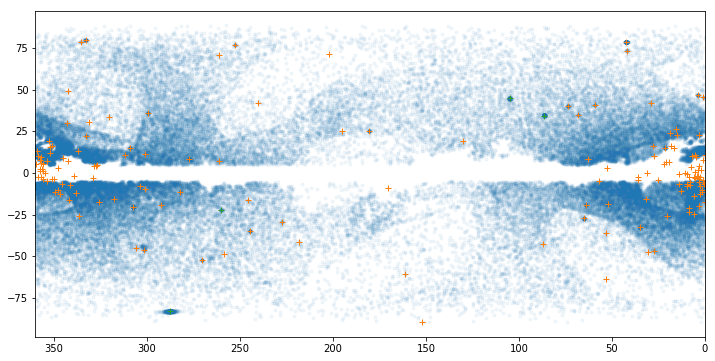

In [20]:
not_LMC = ~( ( (((np.abs(303-l)*np.cos(45/180*np.pi))**2+np.abs(b+45)**2)**0.5 < 10)+\
             (((np.abs(280-l)*np.cos(32/180*np.pi))**2+np.abs(b+32)**2)**0.5 < 15) ) * (np.abs(XYZ[:,2]+35)<20) )
selection_basis = not_LMC * (sfd_ext<0.5) * (np.abs(b)>5) * (np.array(bp_rp)<1.5)# * (np.array(g)>19)

plt.figure(figsize=(12,6))
plt.plot(l[selection_basis], b[selection_basis],'.',alpha=0.05)
plt.plot(l_gc, b_gc,'+',alpha=1)
plt.plot(manu_gc[:,0], manu_gc[:,1],'+',alpha=1)
plt.xlim(360,0)
#plt.ylim(-30,-50)
plt.show()

In [ ]:
Table.read('/datascope/menard/DATA/Gaia/gdr2/vari_time_series_statistics/csv/VariTimeSeriesStatistics_58.csv.gz',format='ascii')

In [ ]:
SELECT source_id,ra,ra_error,dec,dec_error,parallax,parallax_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,bp_rp,radial_velocity,radial_velocity_error,phot_variable_flag,teff_val,a_g_val FROM gaiadr2.gaia_source  
WHERE CONTAINS(POINT('ICRS',gaiadr2.gaia_source.ra,gaiadr2.gaia_source.dec),CIRCLE('ICRS',COORD1(EPOCH_PROP_POS(250.42347500000002,36.4613194,-246.6000,-1.7900,-7.0700,0,2000,2015.5)),COORD2(EPOCH_PROP_POS(250.42347500000002,36.4613194,-246.6000,-1.7900,-7.0700,0,2000,2015.5)),0.1))=1  
and pmra

## metallicity

In [231]:
segue = np.genfromtxt('rrlyrae_sdss9_segue.csv',skip_header=1,dtype=('i8','i8','i8',float,float),delimiter=',',\
                      usecols=(0,1,2,3,4))

array([(    288243845193088, 1237678617437208714, 1237678617437208714, -1.205715, 0.1254339),
       (    288243845193088, 1237678617437208714, 1237678617437208714, -1.205715, 0.1254339),
       (    288243845193088, 1237678617437208714, 1237678617437208714, -1.205715, 0.1254339),
       ...,
       (6917264079699449600, 1237679027031441867,                  -1,       nan,       nan),
       (6917264079699449600, 1237679027031441867,                  -1,       nan,       nan),
       (6917264079699449600, 1237679027031441867,                  -1,       nan,       nan)],
      dtype=[('f0', '<i8'), ('f1', '<i8'), ('f2', '<i8'), ('f3', '<f8'), ('f4', '<f8')])

In [232]:
segue = Table(segue, names=('source_id','sdss_id','best_oid','FeH','FeH_err'))
segue

source_id,sdss_id,best_oid,FeH,FeH_err
int64,int64,int64,float64,float64
288243845193088,1237678617437208714,1237678617437208714,-1.205715,0.1254339
288243845193088,1237678617437208714,1237678617437208714,-1.205715,0.1254339
288243845193088,1237678617437208714,1237678617437208714,-1.205715,0.1254339
288243845193088,1237678617437208714,1237678617437208714,-1.24042,0.01056391
288243845193088,1237678617437208714,1237678617437208714,-1.24042,0.01056391
288243845193088,1237678617437208714,1237678617437208714,-1.24042,0.01056391
288243845193088,1237678617437208714,1237678617437208714,-1.329007,0.0623
288243845193088,1237678617437208714,1237678617437208714,-1.329007,0.0623
288243845193088,1237678617437208714,1237678617437208714,-1.329007,0.0623


In [236]:
source_id = np.unique(segue['source_id'])

### extract start and end index

In [243]:
cursor = 0
index = np.empty((len(source_id),2),dtype=int)
for n,i in enumerate(source_id):
    index[n,0] = cursor
    while cursor < len(segue) and segue['source_id'][cursor] == i:
        cursor += 1
    index[n,1] = cursor

### average metallicity

In [254]:
metallicity = np.empty(len(source_id))
for n in range(len(source_id)):
    start = index[n,0]
    end = index[n,1]
    if segue[start]['best_oid'] == -1:
        metallicity[n] = np.nan
    else:
        metallicity[n] = (segue[start:end]['FeH']/segue[start:end]['FeH_err']**2).sum()/((1/segue[start:end]['FeH_err'])**2).sum()

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:780: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)

/home/scheng/miniconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:781: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)



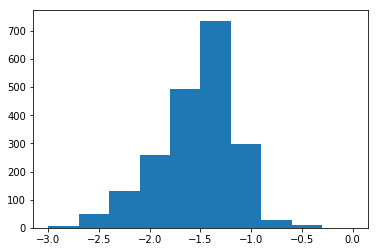

In [257]:
plt.hist(metallicity,range=(-3,0))
plt.show()

In [262]:
np.save('rrlyrae_metallicity.npy',metallicity)

In [264]:
(~np.isnan(metallicity)).sum()

2497

/home/scheng/miniconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, op)(other)



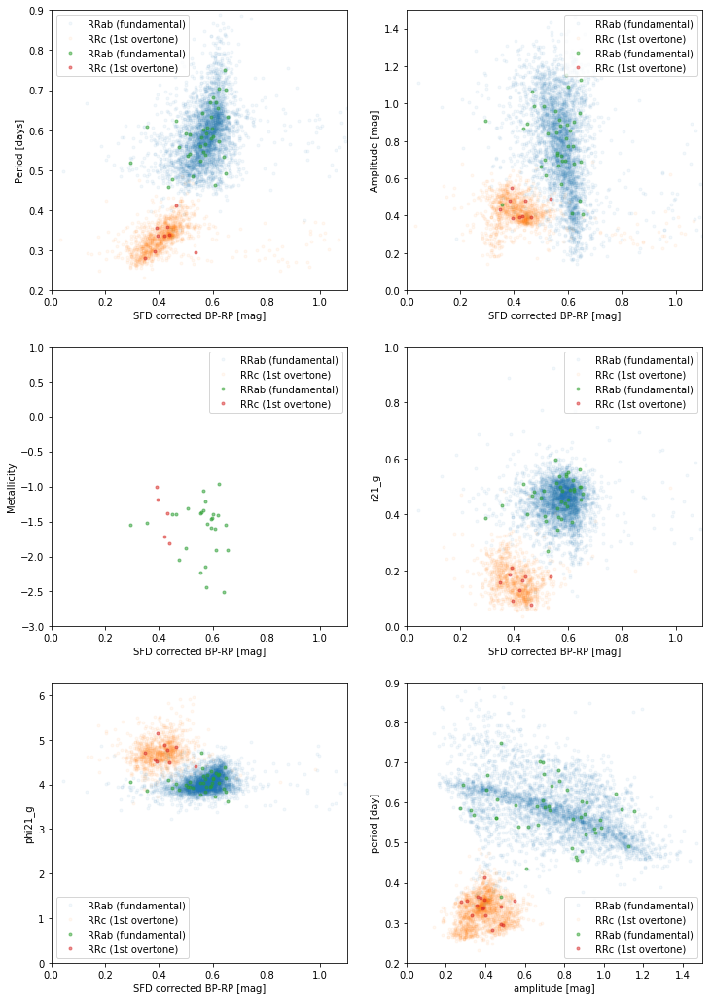

In [265]:
selected_ab = (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRab') * (p>-100) * (table['num_clean_epochs_g']>40)
selected_c = (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRc') * (p>-100) * (table['num_clean_epochs_g']>40)
selected_ab_segue = ~np.isnan(metallicity) * (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRab') * (p>-100) * (table['num_clean_epochs_g']>40)
selected_c_segue = ~np.isnan(metallicity) * (np.abs(b)>35) * (np.abs(sfd_ext)<0.05) * (table['best_classification']==b'RRc') * (p>-100) * (table['num_clean_epochs_g']>40)




plt.figure(figsize=(12,18))
x_axis_list_ab = [table['pf'], table['peak_to_peak_g'], metallicity, table['r21_g'], table['phi21_g']  ]
x_axis_list_c = [table['p1_o'], table['peak_to_peak_g'], metallicity, table['r21_g'], table['phi21_g']  ]
title_list = ['Period [days]', 'Amplitude [mag]', 'Metallicity', 'r21_g', 'phi21_g']
y_range_list = [(0.2,0.9), (0.0,1.5), (-3,1), (0,1), (0,2*np.pi)]
for i in range(5):
    plt.subplot(3,2,i+1)
    selected = selected_ab
    plt.plot(bp_rp[selected]-sfd_ext[selected],x_axis_list_ab[i][selected],'.',alpha=0.05, label='RRab (fundamental)')
    selected = selected_c
    plt.plot(bp_rp[selected]-sfd_ext[selected],x_axis_list_c[i][selected],'.',alpha=0.05, label='RRc (1st overtone)')
    selected = selected_ab_segue
    plt.plot(bp_rp[selected]-sfd_ext[selected],x_axis_list_ab[i][selected],'.',alpha=0.5, label='RRab (fundamental)')
    selected = selected_c_segue
    plt.plot(bp_rp[selected]-sfd_ext[selected],x_axis_list_c[i][selected],'.',alpha=0.5, label='RRc (1st overtone)')
    plt.legend()
    plt.xlim(0,1.1)
    plt.ylim(y_range_list[i])
    plt.xlabel('SFD corrected BP-RP [mag]')
    plt.ylabel(title_list[i])
plt.subplot(3,2,6)
selected = selected_ab
plt.plot(table['peak_to_peak_g'][selected],table['pf'][selected],'.',alpha=0.05, label='RRab (fundamental)')
selected = selected_c
plt.plot(table['peak_to_peak_g'][selected],table['p1_o'][selected],'.',alpha=0.05, label='RRc (1st overtone)')
selected = selected_ab_segue
plt.plot(table['peak_to_peak_g'][selected],table['pf'][selected],'.',alpha=0.5, label='RRab (fundamental)')
selected = selected_c_segue
plt.plot(table['peak_to_peak_g'][selected],table['p1_o'][selected],'.',alpha=0.5, label='RRc (1st overtone)')
plt.legend()
plt.xlim(0,1.5)
plt.ylim(0.2,0.9)
plt.xlabel('amplitude [mag]')
plt.ylabel('period [day]')


plt.show()